Code for **super-resolution** (figures $1$ and $5$ from main paper).. Change `factor` to $8$ to reproduce images from fig. $9$ from supmat.

You can play with parameters and see how they affect the result. 

# Import libs

In [ ]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import argparse
import os
# os.environ['CUDA_VISIBLE_DEVICES'] = '1'
from PIL import Image
import PIL
import numpy as np
from models import *

import paddle
from skimage.metrics import peak_signal_noise_ratio
from models.downsampler import Downsampler

from utils.sr_utils import *
from utils.common_utils import *

imsize = -1 
factor = 8 # 8
enforse_div32 = 'CROP' # we usually need the dimensions to be divisible by a power of two (32 in this case)
PLOT = True

# To produce images from the paper we took *_GT.png images from LapSRN viewer for corresponding factor,
# e.g. x4/zebra_GT.png for factor=4, and x8/zebra_GT.png for factor=8 
path_to_image = 'data/sr/zebra_GT.png'

# Load image and baselines

HR and LR resolutions: (576, 384), (144, 96)


/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/matplotlib/cbook/__init__.py:2349: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated, and in 3.8 it will stop working
  if isinstance(obj, collections.Iterator):
/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/matplotlib/cbook/__init__.py:2366: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated, and in 3.8 it will stop working
  return list(data) if isinstance(data, collections.MappingView) else data


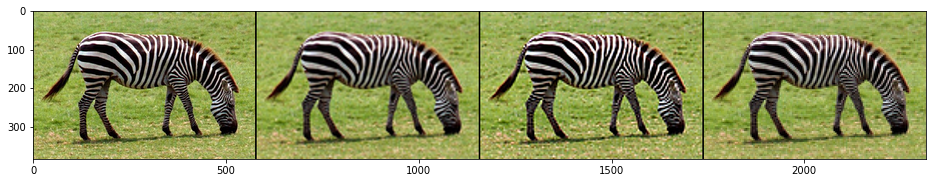

PSNR bicubic: 23.1048   PSNR nearest: 20.8212


In [ ]:
# Starts here
imgs = load_LR_HR_imgs_sr(path_to_image , imsize, factor, enforse_div32)

imgs['bicubic_np'], imgs['sharp_np'], imgs['nearest_np'] = get_baselines(imgs['LR_pil'], imgs['HR_pil'])

if PLOT:
    plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['sharp_np'], imgs['nearest_np']], 4, 12);
    print ('PSNR bicubic: %.4f   PSNR nearest: %.4f' %  (
                                        peak_signal_noise_ratio(imgs['HR_np'], imgs['bicubic_np']), 
                                        peak_signal_noise_ratio(imgs['HR_np'], imgs['nearest_np'])))

# Set up parameters and net

In [ ]:
input_depth = 32
 
INPUT =     'noise'
pad   =     'reflection'
OPT_OVER =  'net'
KERNEL_TYPE='lanczos2'

LR = 0.01
tv_weight = 0.0

OPTIMIZER = 'adam'

if factor == 4: 
    num_iter = 10000
    reg_noise_std = 0.03
elif factor == 8:
    num_iter = 20000
    reg_noise_std = 0.05
else:
    assert False, 'We did not experiment with other factors'

In [ ]:
net_input = get_noise(input_depth, INPUT, (imgs['HR_pil'].size[1], imgs['HR_pil'].size[0]))

NET_TYPE = 'skip' # UNet, ResNet
net = get_net(input_depth, 'skip', pad,
              skip_n33d=128, 
              skip_n33u=128, 
              skip_n11=4, 
              num_scales=5,
              upsample_mode='bilinear')

# Losses
mse = nn.MSELoss()

img_LR_var = paddle.to_tensor(imgs['LR_np']).unsqueeze(0)

downsampler = Downsampler(n_planes=3, factor=factor, kernel_type=KERNEL_TYPE, phase=0.5, preserve_size=True)

# Define closure and optimize

In [ ]:
def closure():
    global i, net_input
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (paddle.normal(shape=noise.shape) * reg_noise_std)

    out_HR = net(net_input)
    out_LR = downsampler(out_HR)

    total_loss = mse(out_LR, img_LR_var) 
    
    if tv_weight > 0:
        total_loss += tv_weight * tv_loss(out_HR)
        
    total_loss.backward()

    # Log
    psnr_LR = peak_signal_noise_ratio(imgs['LR_np'], out_LR.squeeze().numpy())
    psnr_HR = peak_signal_noise_ratio(imgs['HR_np'], out_HR.squeeze().numpy())
    print ('Iteration %05d    PSNR_LR %.3f   PSNR_HR %.3f' % (i, psnr_LR, psnr_HR), '\r', end='')
                      
    # History
    psnr_history.append([psnr_LR, psnr_HR])
    
    if PLOT and i % 100 == 0:
        out_HR_np = out_HR.squeeze().numpy()
        plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], np.clip(out_HR_np, 0, 1)], factor=13, nrows=3)

    i += 1
    
    return total_loss


Starting optimization with ADAM


/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/paddle/nn/layer/norm.py:641: UserWarning: When training, we now always track global mean and variance.
  "When training, we now always track global mean and variance.")


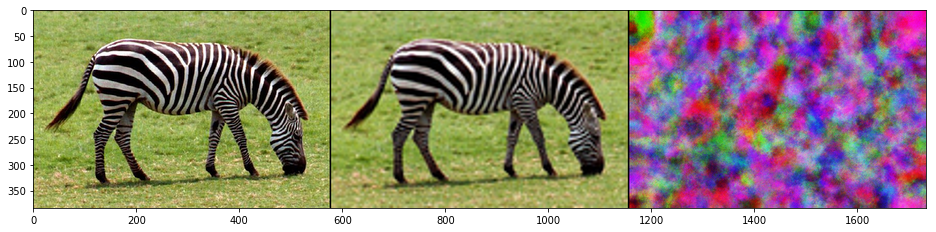

Iteration 00006    PSNR_LR 12.880   PSNR_HR 12.315 


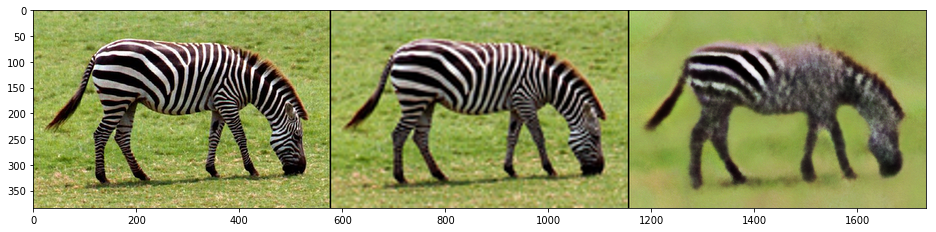

Iteration 00106    PSNR_LR 18.917   PSNR_HR 17.282 


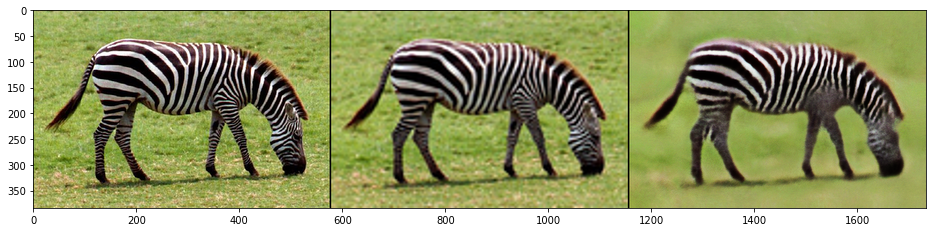

Iteration 00206    PSNR_LR 22.678   PSNR_HR 19.835 


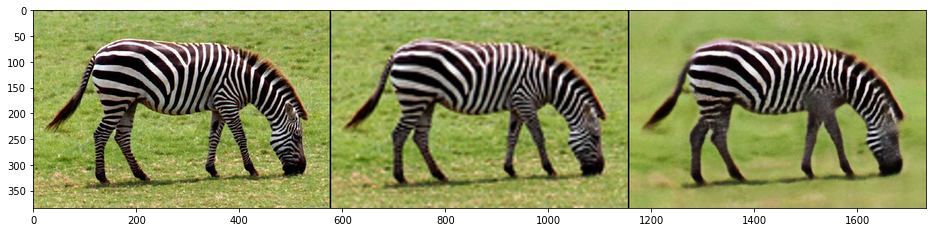

Iteration 00306    PSNR_LR 24.049   PSNR_HR 20.608 


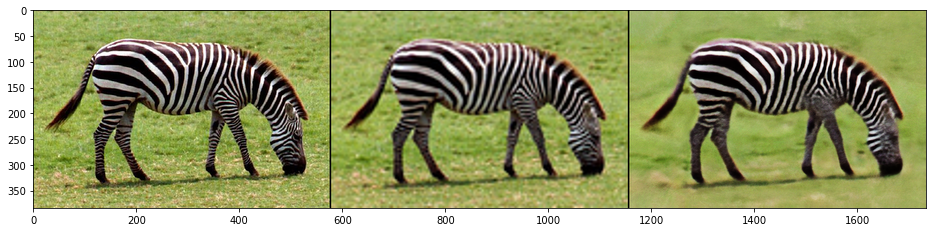

Iteration 00406    PSNR_LR 25.262   PSNR_HR 21.291 


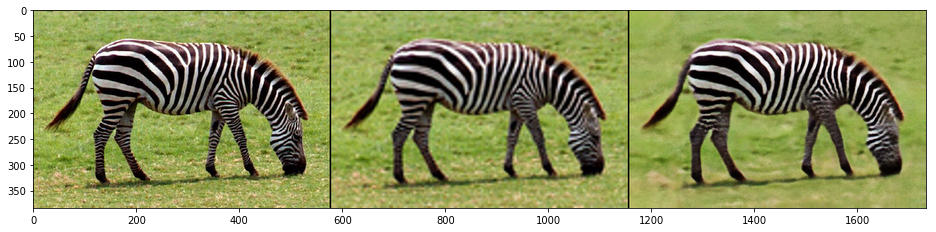

Iteration 00506    PSNR_LR 26.374   PSNR_HR 21.913 


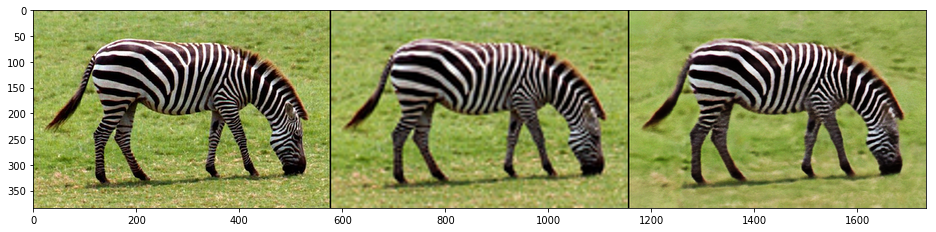

Iteration 00606    PSNR_LR 27.389   PSNR_HR 22.397 


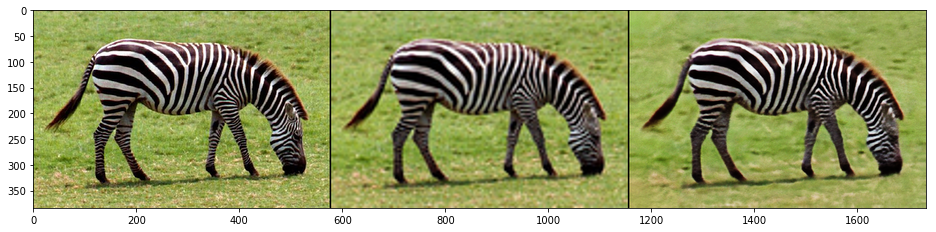

Iteration 00706    PSNR_LR 28.066   PSNR_HR 22.663 


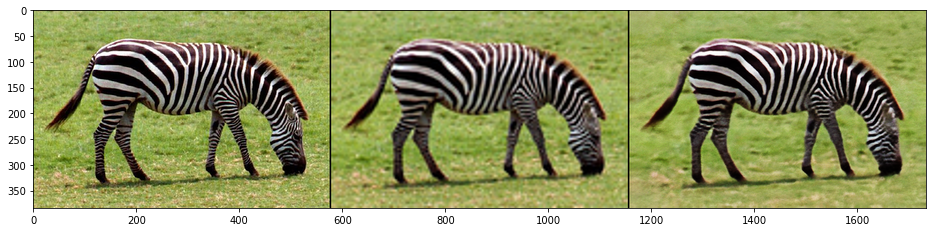

Iteration 00809    PSNR_LR 28.729   PSNR_HR 22.925 


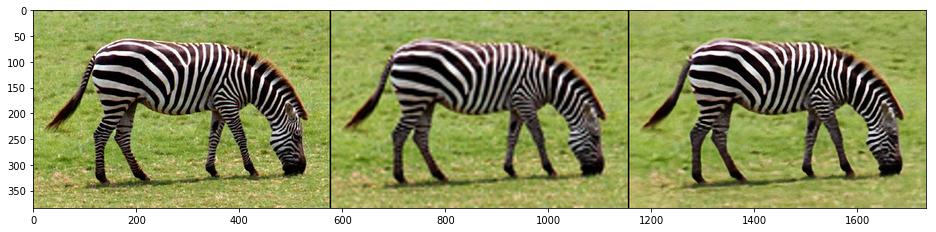

Iteration 00906    PSNR_LR 29.270   PSNR_HR 23.112 


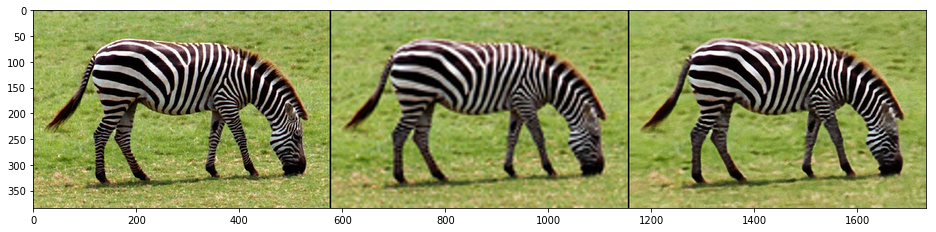

Iteration 01006    PSNR_LR 29.722   PSNR_HR 23.294 


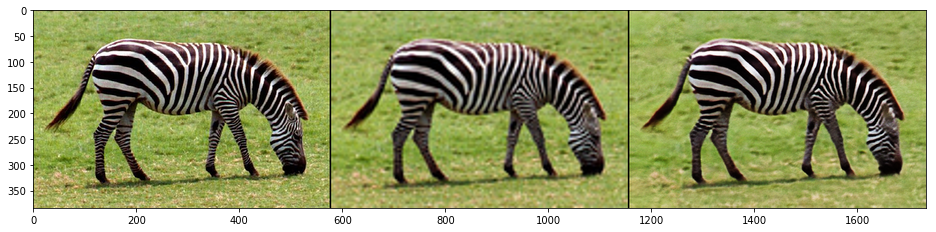

Iteration 01106    PSNR_LR 30.269   PSNR_HR 23.449 


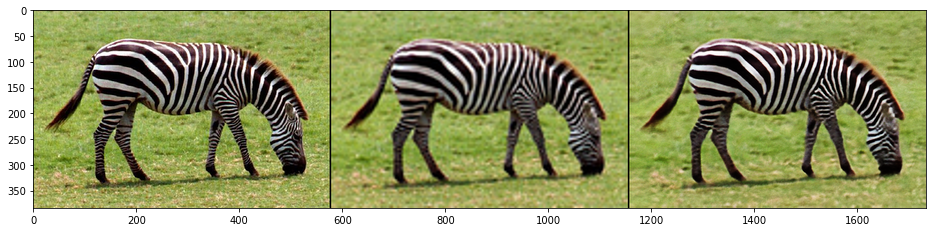

Iteration 01206    PSNR_LR 30.956   PSNR_HR 23.638 


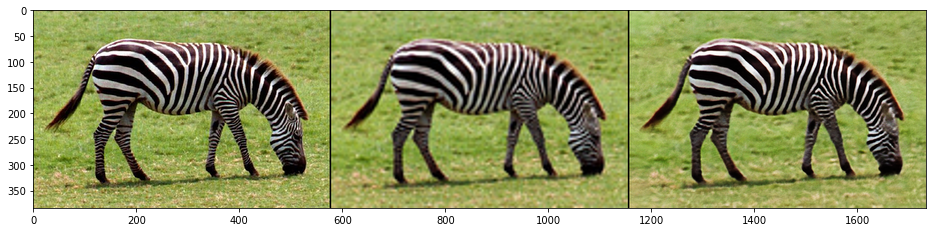

Iteration 01318    PSNR_LR 31.339   PSNR_HR 23.718 


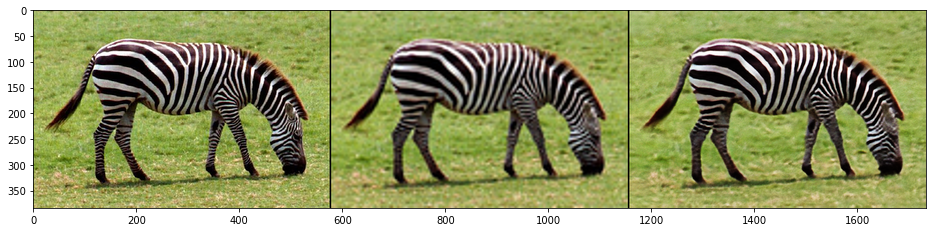

Iteration 01409    PSNR_LR 31.657   PSNR_HR 23.747 


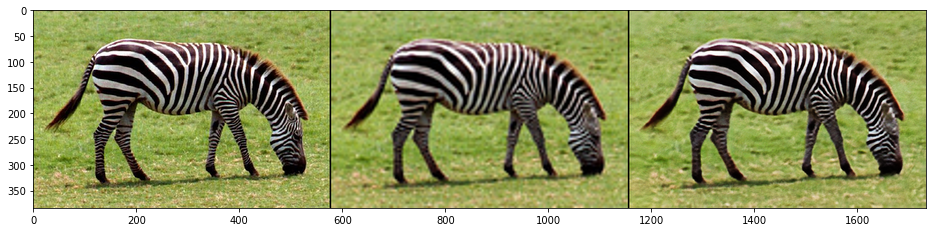

Iteration 01506    PSNR_LR 32.175   PSNR_HR 23.891 


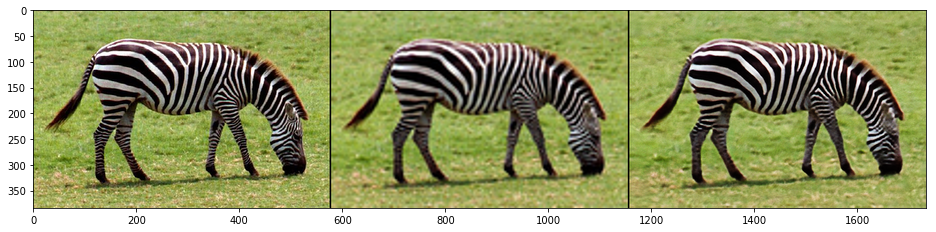

Iteration 01606    PSNR_LR 32.345   PSNR_HR 23.952 


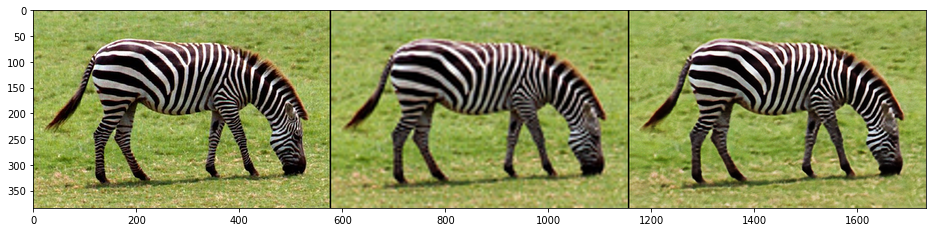

Iteration 01715    PSNR_LR 32.649   PSNR_HR 23.988 


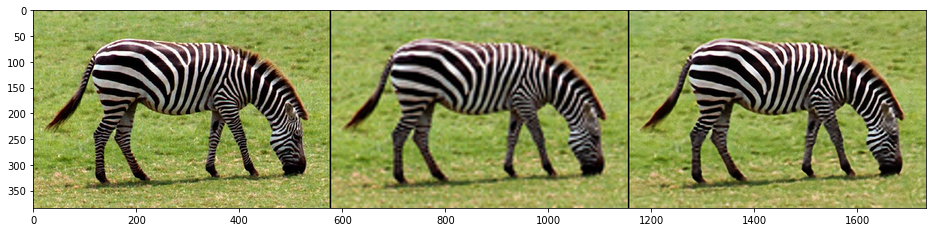

Iteration 01812    PSNR_LR 33.066   PSNR_HR 24.013 


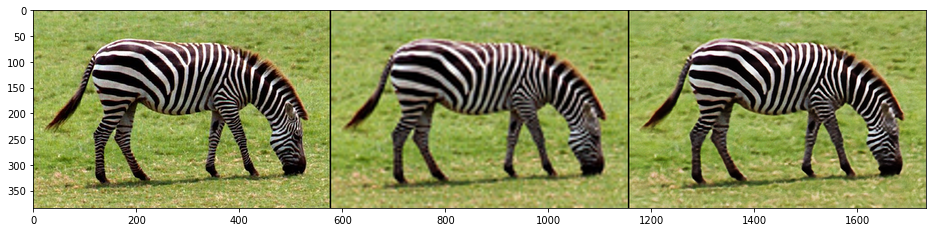

Iteration 01906    PSNR_LR 33.448   PSNR_HR 24.163 


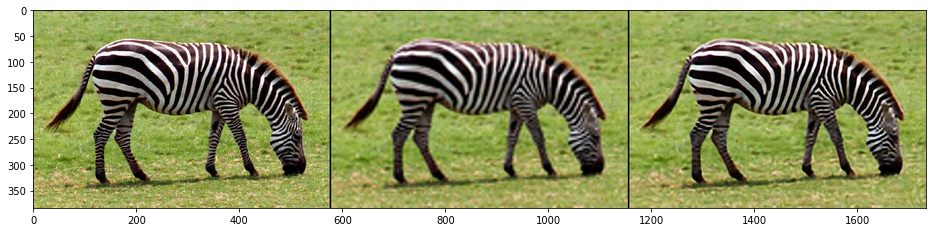

Iteration 02006    PSNR_LR 33.873   PSNR_HR 24.170 


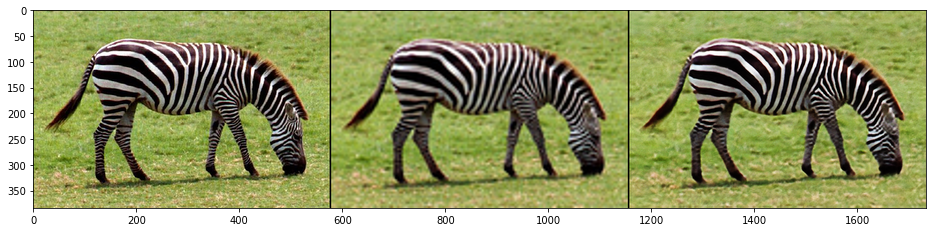

Iteration 02106    PSNR_LR 34.094   PSNR_HR 24.244 


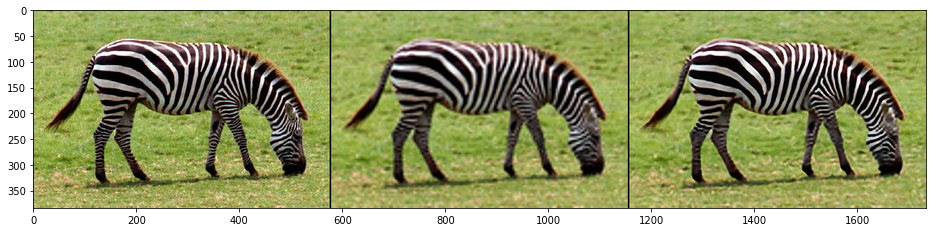

Iteration 02206    PSNR_LR 34.340   PSNR_HR 24.317 


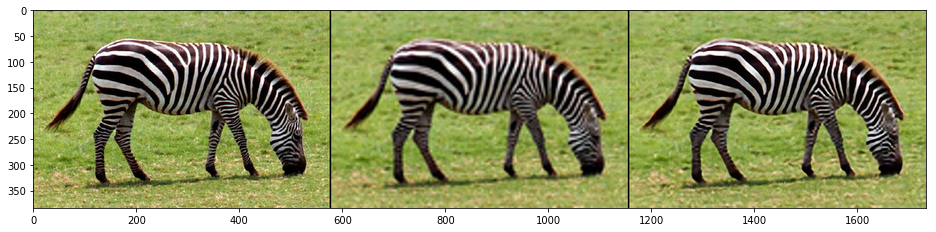

Iteration 02306    PSNR_LR 34.391   PSNR_HR 24.326 


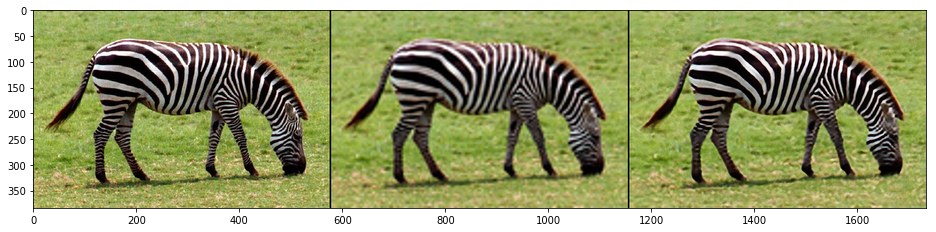

Iteration 02406    PSNR_LR 34.930   PSNR_HR 24.412 


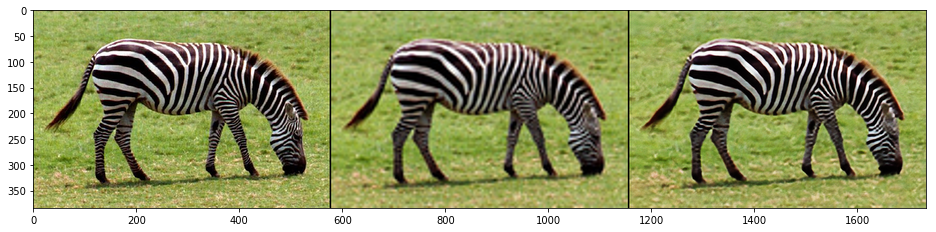

Iteration 02506    PSNR_LR 35.064   PSNR_HR 24.484 


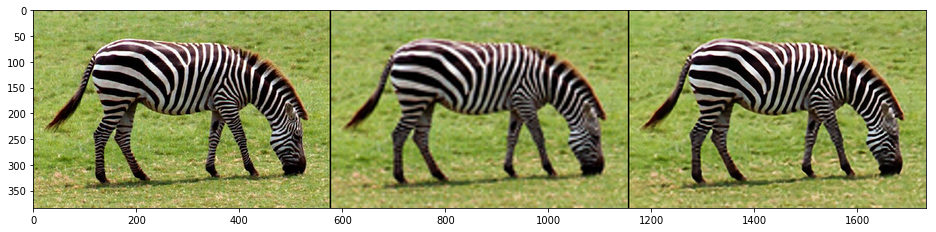

Iteration 02606    PSNR_LR 35.467   PSNR_HR 24.494 


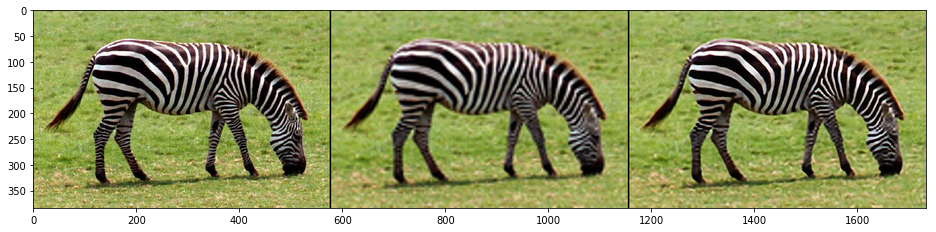

Iteration 02706    PSNR_LR 35.442   PSNR_HR 24.525 


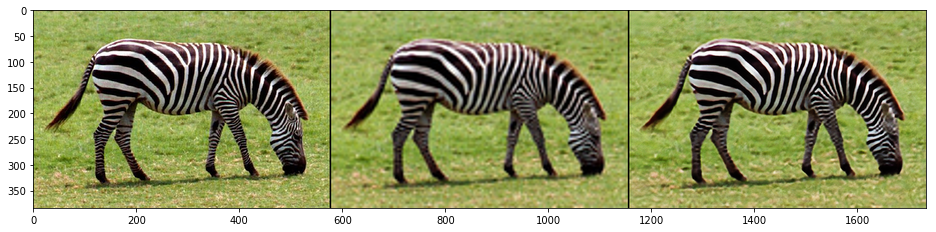

Iteration 02806    PSNR_LR 35.906   PSNR_HR 24.520 


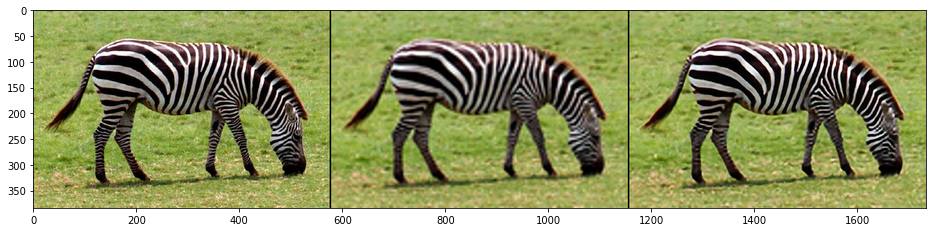

Iteration 02906    PSNR_LR 36.006   PSNR_HR 24.599 


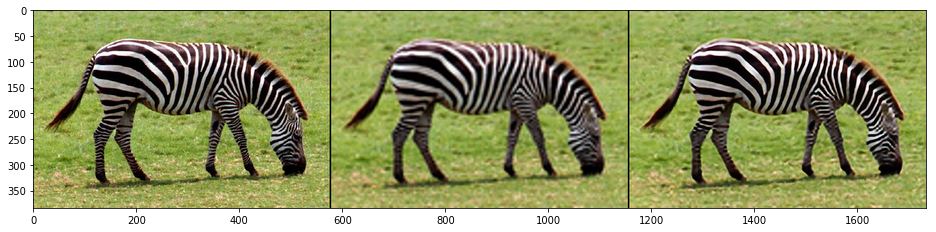

Iteration 03006    PSNR_LR 35.936   PSNR_HR 24.613 


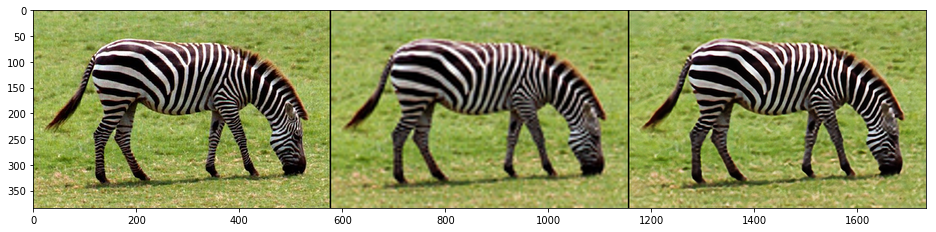

Iteration 03106    PSNR_LR 36.191   PSNR_HR 24.615 


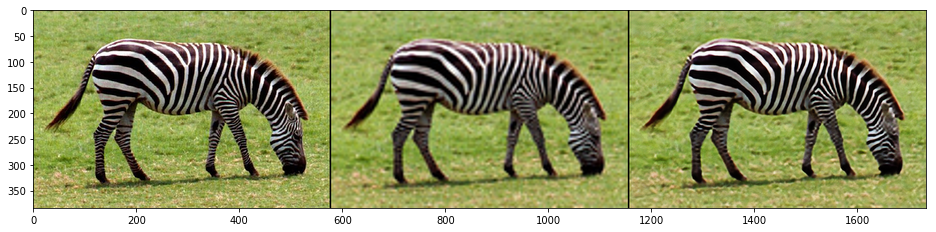

Iteration 03206    PSNR_LR 36.782   PSNR_HR 24.679 


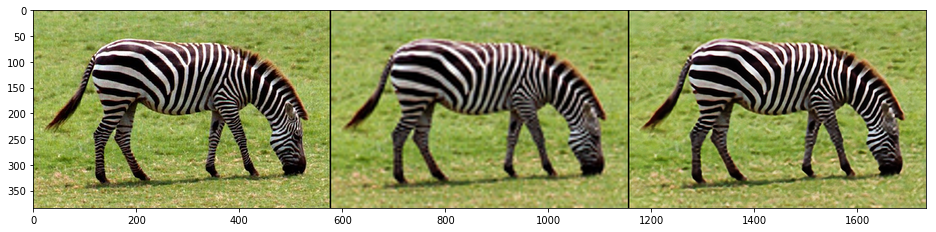

Iteration 03306    PSNR_LR 37.115   PSNR_HR 24.731 


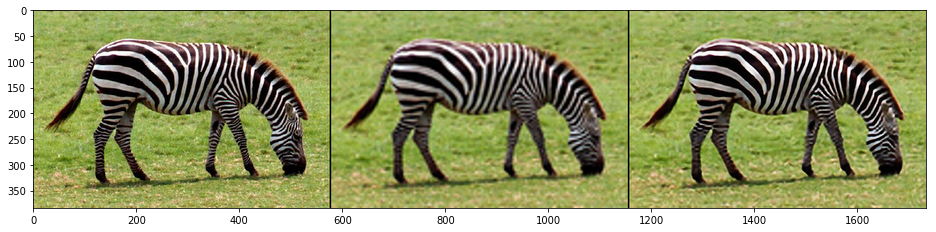

Iteration 03406    PSNR_LR 37.149   PSNR_HR 24.737 


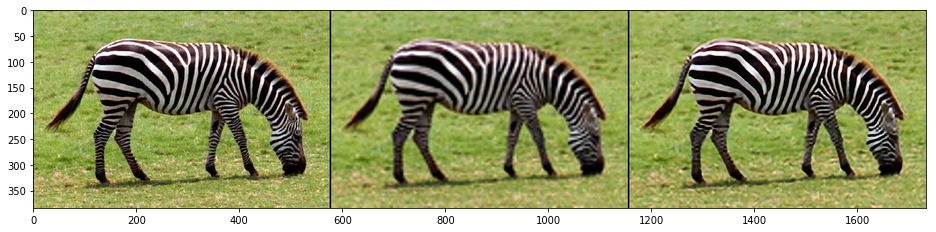

Iteration 03506    PSNR_LR 37.383   PSNR_HR 24.775 


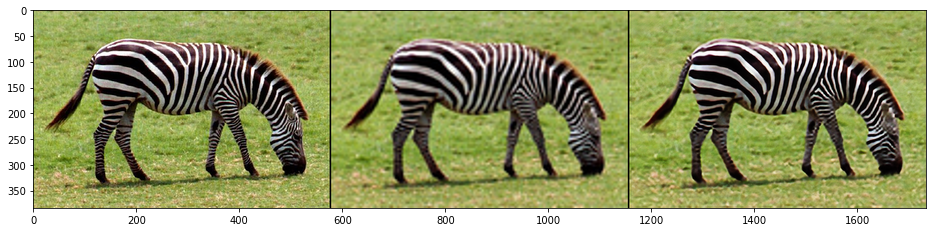

Iteration 03606    PSNR_LR 37.397   PSNR_HR 24.745 


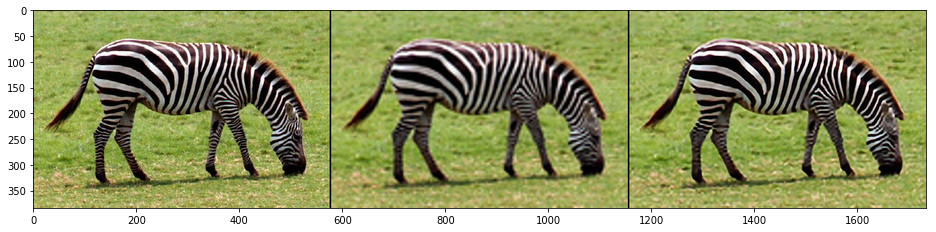

Iteration 03706    PSNR_LR 37.483   PSNR_HR 24.816 


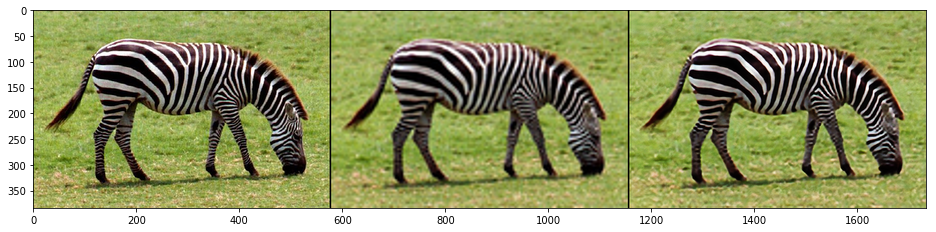

Iteration 03806    PSNR_LR 37.527   PSNR_HR 24.736 


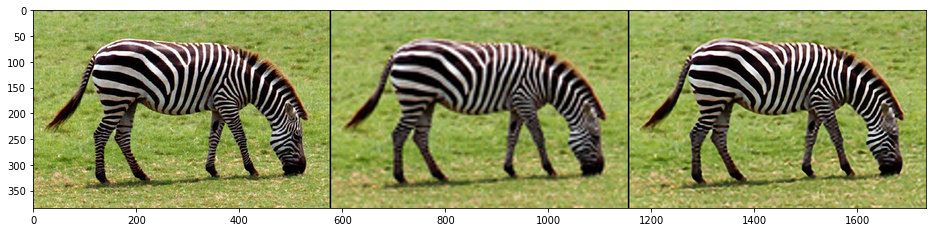

Iteration 03906    PSNR_LR 37.867   PSNR_HR 24.799 


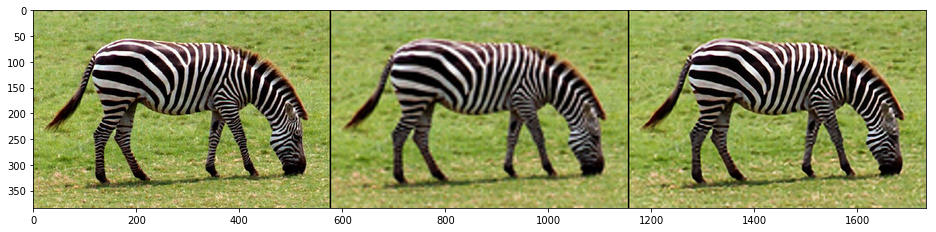

Iteration 04006    PSNR_LR 38.173   PSNR_HR 24.838 


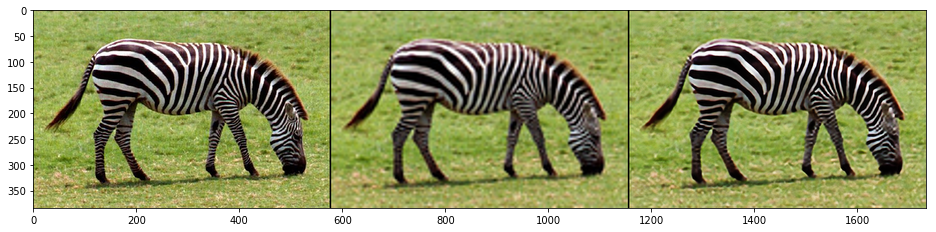

Iteration 04106    PSNR_LR 37.836   PSNR_HR 24.822 


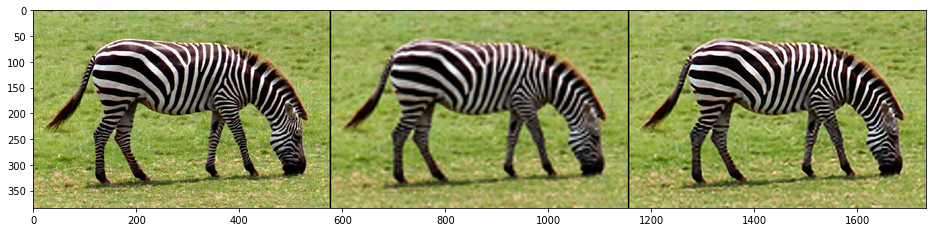

Iteration 04206    PSNR_LR 38.696   PSNR_HR 24.892 


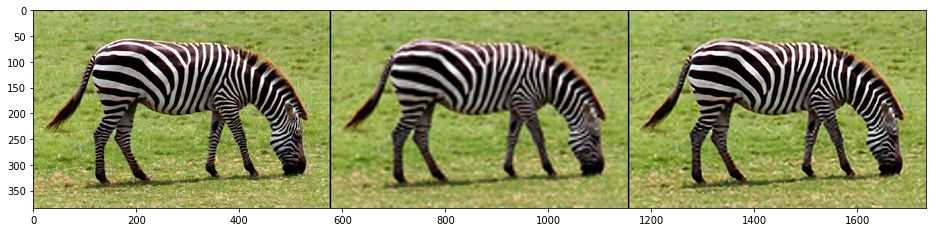

Iteration 04306    PSNR_LR 38.871   PSNR_HR 24.913 


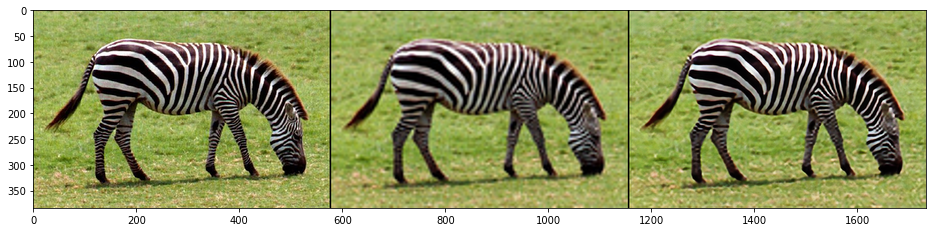

Iteration 04406    PSNR_LR 38.559   PSNR_HR 24.826 


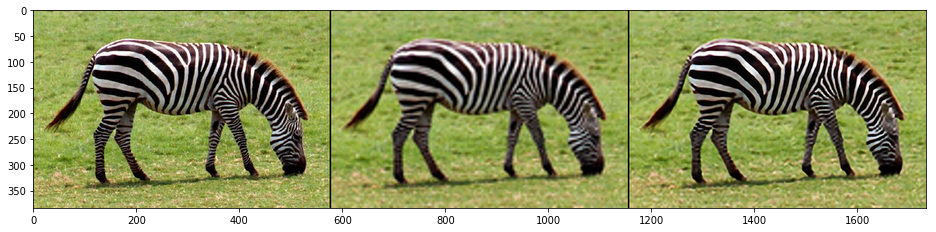

Iteration 04506    PSNR_LR 38.625   PSNR_HR 24.852 


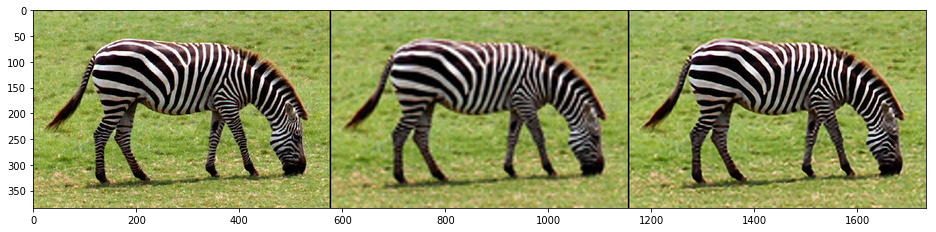

Iteration 04606    PSNR_LR 38.011   PSNR_HR 24.798 


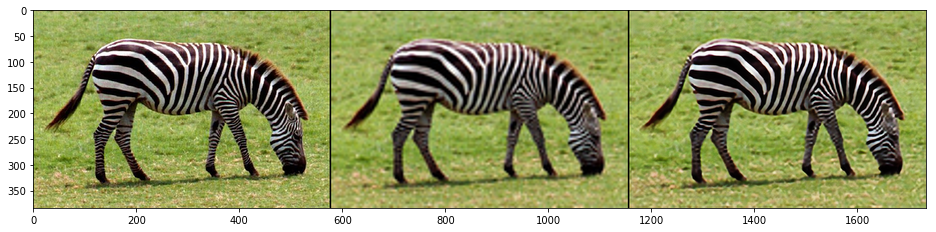

Iteration 04706    PSNR_LR 39.455   PSNR_HR 24.951 


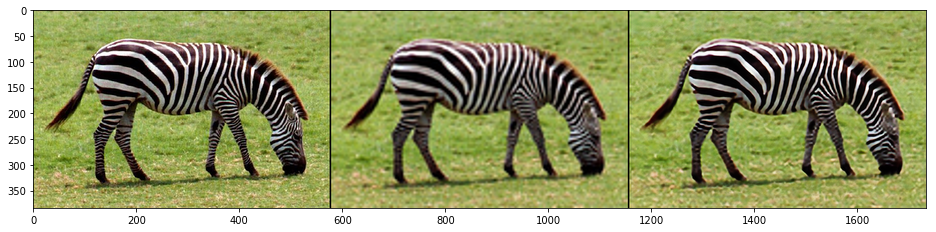

Iteration 04806    PSNR_LR 39.493   PSNR_HR 24.982 


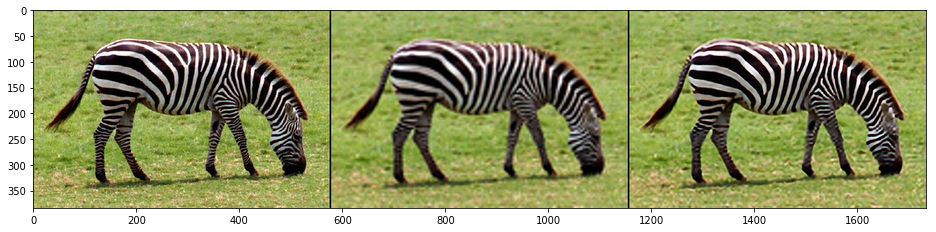

Iteration 04906    PSNR_LR 39.767   PSNR_HR 24.936 


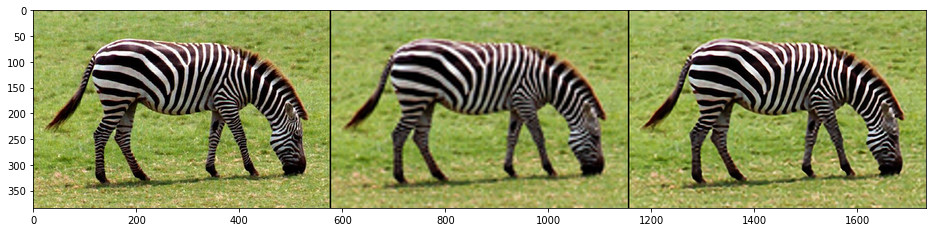

Iteration 05006    PSNR_LR 39.704   PSNR_HR 24.935 


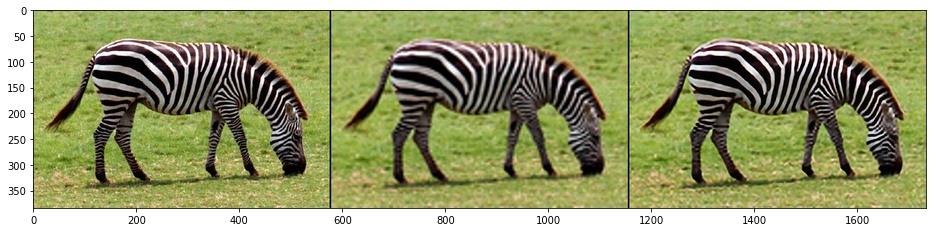

Iteration 05106    PSNR_LR 39.594   PSNR_HR 24.959 


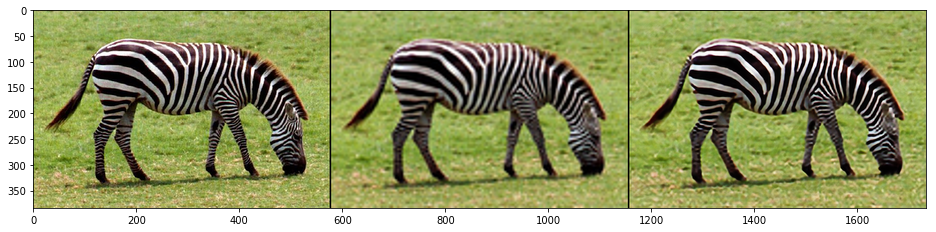

Iteration 05206    PSNR_LR 39.902   PSNR_HR 24.969 


KeyboardInterrupt: 

In [8]:
psnr_history = [] 
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

i = 0
# p = get_params(OPT_OVER, net, net_input)
p = net.parameters()
optimize(OPTIMIZER, p, closure, LR, num_iter)

In [ ]:
out_HR_np = np.clip(net(net_input).squeeze().numpy(), 0, 1)
result_deep_prior = put_in_center(out_HR_np, imgs['orig_np'].shape[1:])

# For the paper we acually took `_bicubic.png` files from LapSRN viewer and used `result_deep_prior` as our result
plot_image_grid([imgs['HR_np'],
                 imgs['bicubic_np'],
                 out_HR_np], factor=13, nrows=3);